---
title: Plane Waves and Math Review - Homework 01
date: 2025-01-12
authors:
  - name: Professor Craig Cahillane
    orcid: 0000-0002-3888-314X
    affiliations:
      - Syracuse University
numbering:
  heading_1: true
  heading_2: true
  heading_3: true
---

This is the first homework assignment for *Lasers and Optomechanics* at Syracuse University.

<span style="color:#ff5555;">**It is due 5pm on Friday, January 23, 2026**</span>

**You will need to complete the questions in this jupyter notebook and submit it via your `git` repo**


In [2]:
from ipywidgets import *
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt

plt.style.use('dark_background')

fontsize = 14
mpl.rcParams.update(
    {
        "text.usetex": False,
        "figure.figsize": (9, 6),
        "figure.autolayout": True,
        "font.family": "serif",
        "font.serif": "georgia",
        # 'mathtext.fontset': 'cm',
        "lines.linewidth": 1.5,
        "font.size": fontsize,
        "xtick.labelsize": fontsize,
        "ytick.labelsize": fontsize,
        "legend.fancybox": True,
        "legend.fontsize": fontsize,
        "legend.framealpha": 0.7,
        "legend.handletextpad": 0.5,
        "legend.labelspacing": 0.2,
        "legend.loc": "best",
        "axes.edgecolor": "#b0b0b0",
        "grid.color": "#707070",  # grid color"
        "xtick.color": "#b0b0b0",
        "ytick.color": "#b0b0b0",
        "savefig.dpi": 80,
        "pdf.compression": 9,
    }
)

**<span style="color:#ffaaff;">Approximations Review</span>**

In this course, you will need to remember and use some basic approximations.\
These approximations all come from taking the [*Taylor Expansion*](https://en.wikipedia.org/wiki/Taylor_series) of a function $f(x)$ about some point $x = a$:
$$f(x)\Bigr|_{x \rightarrow a} \approx f(a) + f'(a) (x-a) + \dfrac{1}{2!} f''(a) (x-a)^2 = \displaystyle \sum_{n=0}^\infty \dfrac{f^{(n)}(a)}{n!}(x - a)^n$$


# <span style="color: #ff5500">Question 1: Binomial Approximation</a>
The binomial approximation to first order in $x$ is as follows:
\begin{align}
(1 + x)^{n} \approx 1 + n x.
\end{align}

## <span style="color:#ccccff;">Question 1A</span>
Derive the binomial approximation using the Taylor Expansion to first order about $x = 0$

## <span style="color:#ccccff;">Question 1B</span>
Find the second and third order terms of the binomial approximation

## <span style="color:#ccccff;">Question 1C</span>
Plot the binomial function on $x \in [-1, 1]$ for $n = \dfrac{1}{2}$.\
Compare to plots of the first, second, and third order binomial approximation.\
At what $x > 0$ does each approximation fail, becoming greater than 5\% error?

## Question 1A Solution: <span style="color:#ff5555;">(This example filled out for you)</span>
Let $$f(x) = (1 + x)^n,$$ 
then at $x = 0$, $$f(0) = 1.$$
Then the first derivative $f'(x)$ is $$f'(x) = n (1 + x)^{n-1}$$
and the derivative evaluated at $x = 0$ is $$f'(0) = n$$

The Taylor Expansion to first order then becomes 
\begin{align}
f(x)\Bigr|_{x \rightarrow 0} &\approx f(0) + f'(0) x\\~\\
&= 1 + n x
\end{align}

## Question 1B Solution:
Taking the second and third derivatives, and evaluating at 0 yields
\begin{align}
f''(x) &= n (n-1) (1 + x)^{n-2} \\
f'''(x) &= n (n-1) (n-2) (1 + x)^{n-3} \\~\\
f''(0) &= n (n-1)\\
f''(0) &= n (n-1) (n-2)
\end{align}

The second order expansion is
\begin{align}
f(x)\Bigr|_{x \rightarrow 0} &\approx f(0) + f'(0) x + \dfrac{1}{2!} f''(0) x^2\\~\\
&= 1 + n x + \dfrac{1}{2} n (n-1) x^2
\end{align}

The third order expansion is
\begin{align}
f(x)\Bigr|_{x \rightarrow 0} &\approx f(0) + f'(0) x + \dfrac{1}{2!} f''(0) x^2 + \dfrac{1}{3!} f'''(0) x^3\\~\\
&= 1 + n x + \dfrac{1}{2} n (n-1) x^2 + \dfrac{1}{6} n (n-1) (n-2) x^3
\end{align}

In [9]:
def binom(xx:float, nn:float):
    """Binomial function (1 + xx)^nn
    
    Inputs:
    -------
    xx: float or array of floats
        binomial variable
    nn: float
        binomial exponent

    Output:
    -------
    binom: float or array of floats
        binomial expansion
    """
    return (1 + xx)**nn

In [10]:
# Parameter definitions.  Protip: never make single-letter variable names
nn = 0.5
xx = np.linspace(-1, 2, 100)

taylor0 = 1
taylor1 = taylor0 + nn * xx
taylor2 = taylor1 + 0.5 * nn * (nn - 1) * xx**2
taylor3 = taylor2 + (1/6) * nn * (nn - 1) * (nn - 2) * xx**3

In [11]:
# At which x does the error become greater than 10%?
# First, we divide the approximation by the real function,
# Second, we subtract 1 from that ratio
# Third, we take the absolute value of the subtraction
# Fourth, we look for the first location where the final result is greater than 0.1
# Fifth, we find where x > 0
# Sixth, we take the intersection of the indices found
# Seventh, we find the first index where the error is large for plotting
error = 0.05
model = binom(xx, nn)

xx_errors = np.array([])
for taylor in [taylor1, taylor2, taylor3]:
    abs_errors = np.abs(taylor/model - 1) # final result
    indices_error = np.argwhere(abs_errors > error)
    indices_x = np.argwhere(xx > 0)
    
    indices_final = np.intersect1d(indices_error, indices_x)
    index = indices_final[0]
    
    xx_errors = np.append(xx_errors, xx[index])
print(xx_errors)

[0.87878788 1.3030303  1.42424242]


/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_76054/3003632814.py:14: RuntimeWarning: divide by zero encountered in divide
  abs_errors = np.abs(taylor/model - 1) # final result


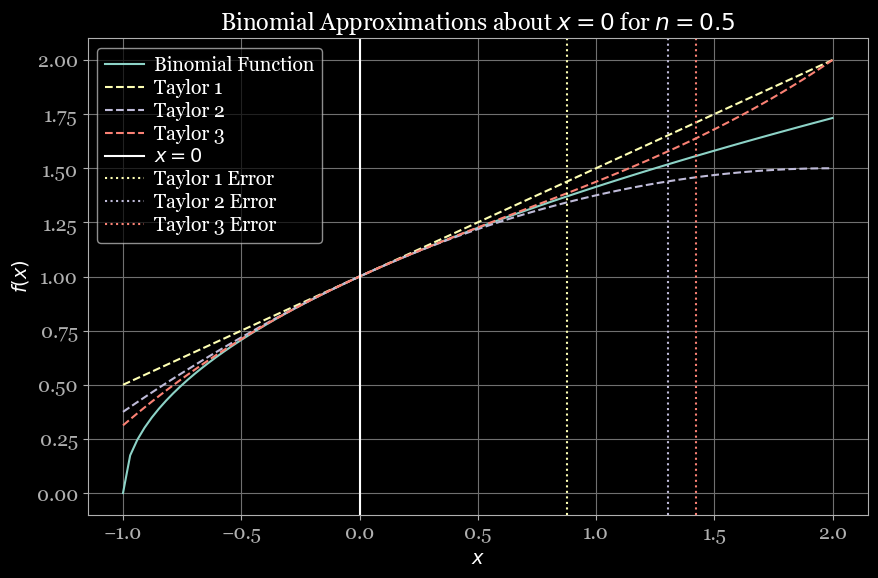

In [12]:
fig, s1 = plt.subplots(1)

s1.plot(xx, binom(xx, nn), label="Binomial Function")
s1.plot(xx, taylor1, ls="--", label="Taylor 1")
s1.plot(xx, taylor2, ls="--", label="Taylor 2")
s1.plot(xx, taylor3, ls="--", label="Taylor 3")

s1.axvline(x=0, label=f"$x = 0$")

for ii, xx_error in enumerate(xx_errors):
    s1.axvline(x=xx_error, color=f"C{ii+1}",ls=":", label=f"Taylor {ii+1} Error")

s1.set_title("Binomial Approximations about $x = 0$ for $n = " + f"{nn}" + "$")
s1.set_xlabel("$x$")
s1.set_ylabel("$f(x)$")
s1.legend()
s1.grid()
plt.show()

# <span style="color: #ff5500">Question 2: Sine and Cosine Approximations</a>

## Question 2A: Sine 
Repeat the Taylor Expansion approximations for sine  to second order about $x = 0$.\
Make the plots, but you don't need to calculate the 5\% error point.

## Question 2B: Cosine
Repeat the Taylor Expansion approximations for cosine to second order about $x = 0$.\
Make the plots, but you don't need to calculate the 5\% error point.


# <span style="color:rgb(255, 0, 200)">Question 2: My Answers</a>

## Question 2A: 

Here, $$ f(x)=\sin(x) \rightarrow f(0)= \sin(0)=0 $$
then
$$ f'(x)=\cos(x) \rightarrow f'(0)= \cos(0)=1$$
$$ f''(x)=-\sin(x) \rightarrow f''(0)= -\sin(0)=0$$

So, the second order expansion is
\begin{align}
f(x)\Bigr|_{x \rightarrow 0} &\approx f(0) + f'(0) x + \dfrac{1}{2!} f''(0) x^2\\~\\
&= 0 + x + 0 = x
\end{align}




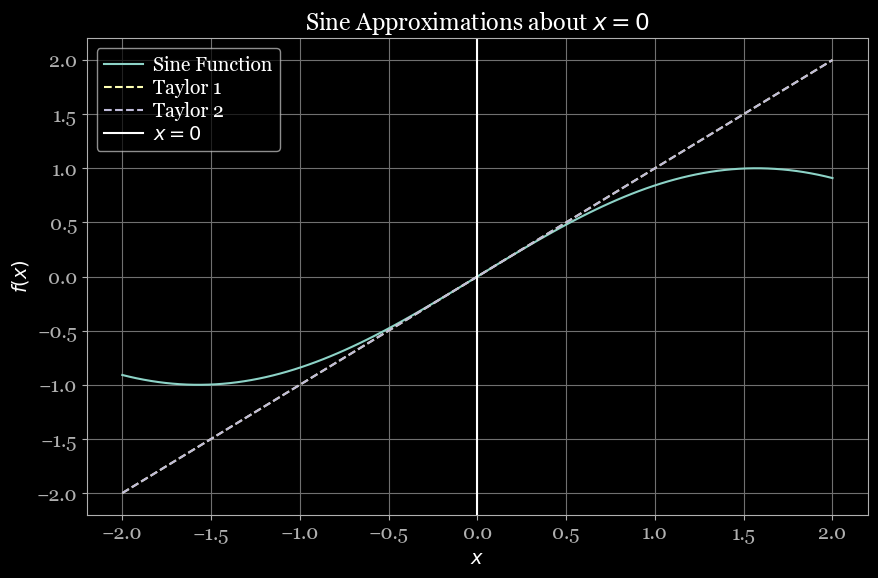

In [32]:
###----------- 2A Plot -----------###

def sine(xx:float):
    yy = np.sin(xx)
    return (yy)

# Parameter definitions
xx = np.linspace(-2, 2, 100)

taylor0 = 0
taylor1 = taylor0 + xx
taylor2 = taylor1 + 0

#Plotting
fig, s2 = plt.subplots(1)

s2.plot(xx, sine(xx), label="Sine Function")
s2.plot(xx, taylor1, ls="--", label="Taylor 1")
s2.plot(xx, taylor2, ls="--", label="Taylor 2")


s2.axvline(x=0, label=f"$x = 0$")


s2.set_title("Sine Approximations about $x = 0$")
s2.set_xlabel("$x$")
s2.set_ylabel("$f(x)$")
s2.legend()
s2.grid()
plt.show()



## Question 2B: 

Here, $$ f(x)=\cos(x) \rightarrow f(0)= \cos(0)=1 $$
then
$$ f'(x)=-\sin(x) \rightarrow f'(0)= -\sin(0)=0$$
$$ f''(x)=-\cos(x) \rightarrow f''(0)= -\cos(0)=-1$$

So, the second order expansion is
\begin{align}
f(x)\Bigr|_{x \rightarrow 0} &\approx f(0) + f'(0) x + \dfrac{1}{2!} f''(0) x^2\\~\\
&= 1 + 0 + -\dfrac{1}{2!}x^2 = 1 - \dfrac{1}{2!} x^2
\end{align}

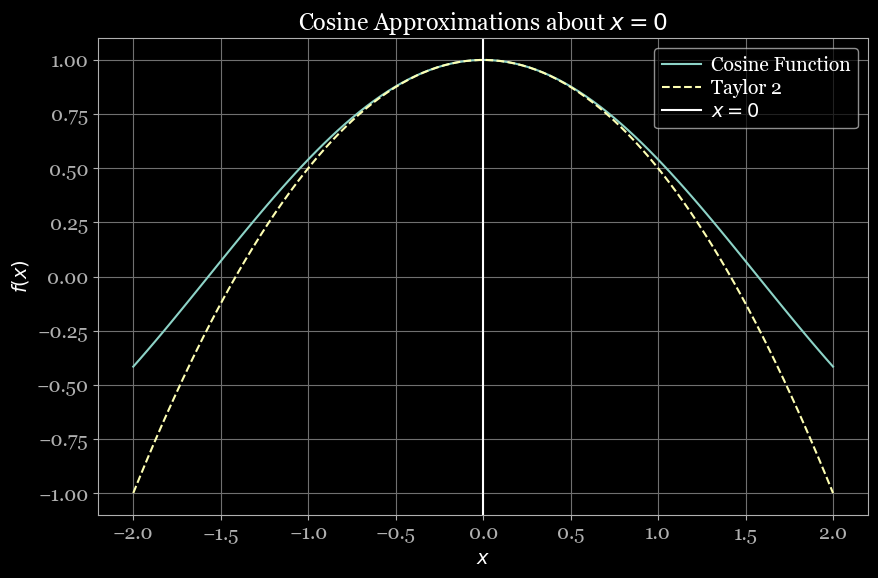

In [47]:
###----------- 2B Plot -----------###

def cosine(xx:float):
    yy = np.cos(xx)
    return (yy)

# Parameter definitions
xx = np.linspace(-2, 2, 100)

taylor0 = 1
taylor1 = taylor0 + 0
taylor2 = taylor1 - ((xx)**2)/2

#Plotting
fig, s3 = plt.subplots(1)

s3.plot(xx, cosine(xx), label="Cosine Function")
#s3.plot(xx, taylor1, ls="--", label="Taylor 1")
#s3.axvline(xx, 1, ls="--", label="Taylor 1")
s3.plot(xx, taylor2, ls="--", label="Taylor 2")


s3.axvline(x=0, label=f"$x = 0$")

s3.set_title("Cosine Approximations about $x = 0$")
s3.set_xlabel("$x$")
s3.set_ylabel("$f(x)$")
s3.legend()
s3.grid()
plt.show()

# <span style="color: #ff5500">Question 3: Complex Number Review</a>

## Question 3A:
Plot the following complex function on a domain of $\phi \in [0, 2 \pi]$:
\begin{align}
z_1(\phi) &= 2 + e^{i \phi}\\
z_2(\phi) &= \dfrac{3}{2 - e^{i \phi}}\\
z_3(\phi) &= e^{(\sigma + i \omega) t}
\end{align}
where for $z_4$, $\sigma = -0.5$, and $\omega = 1$.

## Question 3B:
Calculate the magnitude $r(\phi)$ and argument $\theta(\phi)$ for each $z_i$.

## Question 3C:
Calculate the velocity of the phasors with respect to $\phi$, and draw them for each $z_i$ evaluated at $\phi = \left\{0, \dfrac{\pi}{2}, \pi, \dfrac{3\pi}{2} \right\}$

## Question 3D:
What is the primary difference between $z_1$ and $z_2$?

## Question 3E:
For $z_3$, substitute $t$ for $\phi$, and calculate the normalized time derivatives : $\dfrac{\dot{z_3}}{z_3}$, $\dfrac{\ddot{z_3}}{z_3}$

and find expressions for the normalized real polar coordinates $\dfrac{\dot{r}}{r}, \dfrac{\ddot{r}}{r}, \dot{\theta}, \ddot{\theta}$.

Discuss how the expressions you found for the polar coordinates relate to the path you plotted for $z_3$ in part A.  

What happens if $\sigma = +0.5$?

# <span style="color:rgb(255, 0, 200)">Question 3: My Answers</a>

## Question 3A (easier to just plot them all together):


<>:32: SyntaxWarning: invalid escape sequence '\p'
<>:33: SyntaxWarning: invalid escape sequence '\p'
<>:34: SyntaxWarning: invalid escape sequence '\s'
<>:32: SyntaxWarning: invalid escape sequence '\p'
<>:33: SyntaxWarning: invalid escape sequence '\p'
<>:34: SyntaxWarning: invalid escape sequence '\s'
/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_19964/566259579.py:32: SyntaxWarning: invalid escape sequence '\p'
  arc1, = ax.plot(re1,im1,color="#ff97aa", lw=3, label="$z_1 = 2 + e^{i\phi}$")
/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_19964/566259579.py:33: SyntaxWarning: invalid escape sequence '\p'
  arc2, = ax.plot(re2,im2,color="#7417ff", linestyle='dashed', lw=2, label="$z_2 = 3/({2-e^{i\phi}})$")
/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_19964/566259579.py:34: SyntaxWarning: invalid escape sequence '\s'
  arc3, = ax.plot(re3,im3,color="#ee387e", lw=2, label="$z_2 = e^{(\sigma + i\omega)\phi} ; \sigma = -0.5, \omega=1$")


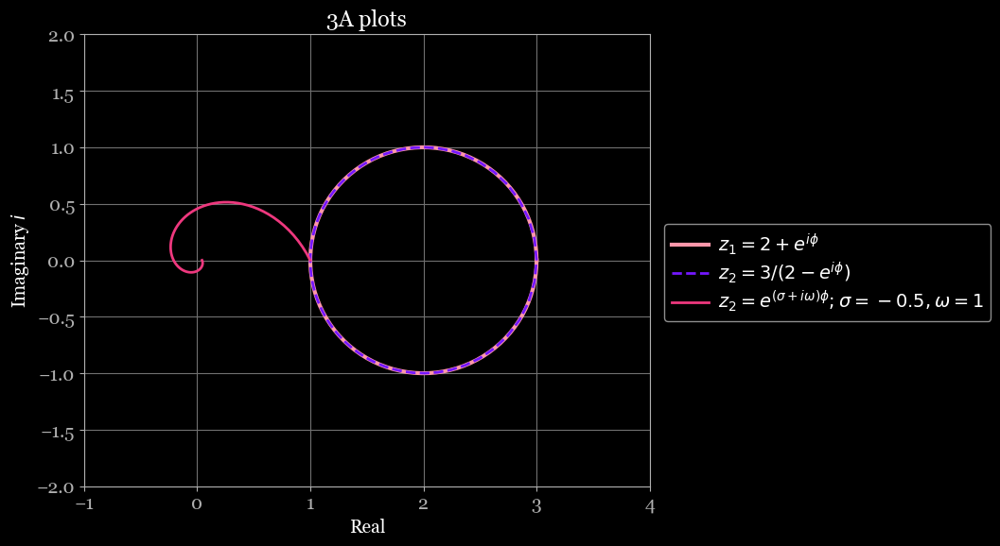

In [99]:
import math

def z1(phi):
    z1 = 2 + np.exp(1j * phi)
    return z1
re1 = z1(phis).real
im1 = z1(phis).imag
#print(re1)

def z2(phi):
    z2 = 3 / (2 - np.exp(1j * phi))
    return z2
re2 = z2(phis).real
im2 = z2(phis).imag


def z3(phi):
    z3 = np.exp( (-phi/2) + (1j*phi))
    return z3
re3 = z3(phis).real
im3 = z3(phis).imag


phis = np.linspace(0, 2 * np.pi, 100)
phi_vals = [0, np.pi/2, np.pi, (3 * np.pi)/2]


fig = plt.figure(figsize=(11,6))
ax = fig.add_subplot()


arc1, = ax.plot(re1,im1,color="#ff97aa", lw=3, label="$z_1 = 2 + e^{i\phi}$")
arc2, = ax.plot(re2,im2,color="#7417ff", linestyle='dashed', lw=2, label="$z_2 = 3/({2-e^{i\phi}})$")
arc3, = ax.plot(re3,im3,color="#ee387e", lw=2, label="$z_2 = e^{(\sigma + i\omega)\phi} ; \sigma = -0.5, \omega=1$")




ax.set_xlabel("Real")
ax.set_ylabel("Imaginary $i$")
ax.set_xlim([-1, 4])
ax.set_ylim([-2, 2])
ax.grid()

ax.set_title("3A plots")

ax.legend(bbox_to_anchor=(1.01, 0.6))
ax.set_aspect('equal')




## Question 3B:

z_1:

\begin{align}\\

r_1^2(\phi)= |z(\phi)|^2 = (2+e^{i\phi})(2+e^{-i\phi})\\
= 5+2(e^{i\phi}+e^{-i\phi})\\
=5 + 4\cos(\phi)\\

\\
Re(z_1(\phi))= 2+\cos(\phi)\\
Im(z_1(\phi))= \sin(\phi)\\

\theta(\phi)=\arctan2({\sin(\phi),2+\cos(\phi)})\\
\\ 
\end{align}

z_2:
\begin{align}\\
r_2^2(\phi)= \frac{3}{(2-e^{i\phi})}\frac{3}{(2-e^{-i\phi})}\\
=\frac{9}{5-4\cos(\phi)}\\
\\
\end{align}

To find real and imaginary parts of z_2 we use 

\begin{align}\\

\frac{3}{(2-e^{i\phi})}\frac{2-e^{-i\phi}}{(2-e^{-i\phi})}=\frac{3(2-\cos{\phi}-i\sin{\phi})}{{5-4\cos(\phi)}}\\

\\
Re(z_2(\phi))= \frac{3(2+\cos(\phi))}{5-4\cos{\phi}}\\
Im(z_2(\phi))= \frac{3\sin(\phi)}{5-4\cos{\phi}}\\
\theta(\phi)=\arctan2(\frac{3\sin(\phi)}{5-4\cos{\phi}},\frac{3(2+\cos(\phi))}{5-4\cos{\phi}})\\
\\



\end{align}

z_3:

\begin{align}\\
r_3^2(\phi)= e^{\sigma\phi}e^{i\omega\phi}e^{-i\omega\phi}\\
= e^{\sigma \phi}\\
= e^{-\frac{\phi}{2}}\\

\\
Re(z_3(\phi))= e^{\sigma \phi}\cos(\omega \phi)=e^{-\frac{\phi}{2}}\cos{\phi}\\
Im(z_3(\phi))= e^{\sigma \phi}\sin(\omega \phi)=e^{-\frac{\phi}{2}}\sin{\phi}\\
\theta(\phi)=\arctan2(e^{-\frac{\phi}{2}}\sin{\phi},e^{-\frac{\phi}{2}}\cos{\phi})
\\

\end{align}

## Question 3C:

Velocities at 0, pi/2, pi, and 3pi/2 respectively: real parts= [ 0.0000000e+00 -1.0000000e+00 -1.2246468e-16  1.0000000e+00] imag parts= [ 1.0000000e+00  6.1232340e-17 -1.0000000e+00 -1.8369702e-16]


<>:31: SyntaxWarning: invalid escape sequence '\p'
<>:31: SyntaxWarning: invalid escape sequence '\p'
/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_19964/1968399416.py:31: SyntaxWarning: invalid escape sequence '\p'
  arc1, = ax.plot(re1,im1,color="#ff97aa", lw=3, label="$z_1 = 2 + e^{i\phi}$")


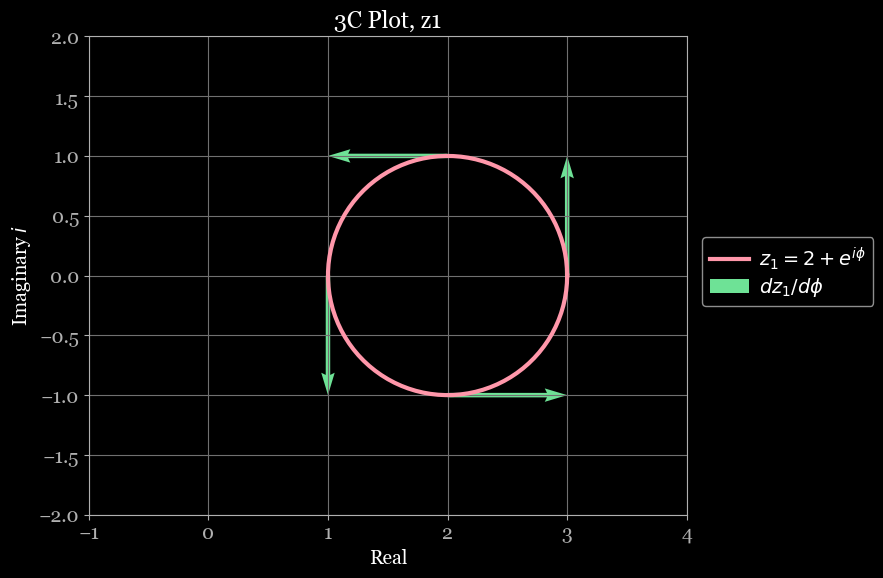

In [147]:
import math

phi_vals = np.array([0, np.pi/2, np.pi, (3 * np.pi)/2])
phis = np.linspace(0, 2 * np.pi, 100)

def z1(phi):
    z1 = 2 + np.exp(1j * phi)
    return z1

def dz1(phi_vals):
    dz1 = 1j * np.exp(1j * phi_vals)
    return dz1

re1 = z1(phis).real
im1 = z1(phis).imag

re11 = z1(phi_vals).real
im11 = z1(phi_vals).imag

dre1 = dz1(phi_vals).real
dim1 = dz1(phi_vals).imag

print("Velocities at 0, pi/2, pi, and 3pi/2 respectively:","real parts=",dre1,"imag parts=",dim1)



fig = plt.figure(figsize=(11,6))
ax = fig.add_subplot()


arc1, = ax.plot(re1,im1,color="#ff97aa", lw=3, label="$z_1 = 2 + e^{i\phi}$")
ax.quiver(re11, im11, dre1, dim1, angles='xy', scale_units='xy',scale=1, color="#6ee296",label=r"$dz_1/d\phi$")


ax.set_xlabel("Real")
ax.set_ylabel("Imaginary $i$")
ax.set_xlim([-1, 4])
ax.set_ylim([-2, 2])
ax.grid()

ax.set_title("3C Plot, z1")

ax.legend(bbox_to_anchor=(1.01, 0.6))
ax.set_aspect('equal')




<>:29: SyntaxWarning: invalid escape sequence '\p'
<>:29: SyntaxWarning: invalid escape sequence '\p'
/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_19964/2378680377.py:29: SyntaxWarning: invalid escape sequence '\p'
  arc2, = ax.plot(re2,im2,color="#7417ff", linestyle='dashed', lw=2, label="$z_2 = 3/({2-e^{i\phi}})$")


Velocities at 0, pi/2, pi, and 3pi/2 respectively: real parts= [ 0.00000000e+00 -3.60000000e-01 -1.36071867e-17  3.60000000e-01] imag parts= [ 3.         -0.48       -0.33333333 -0.48      ]


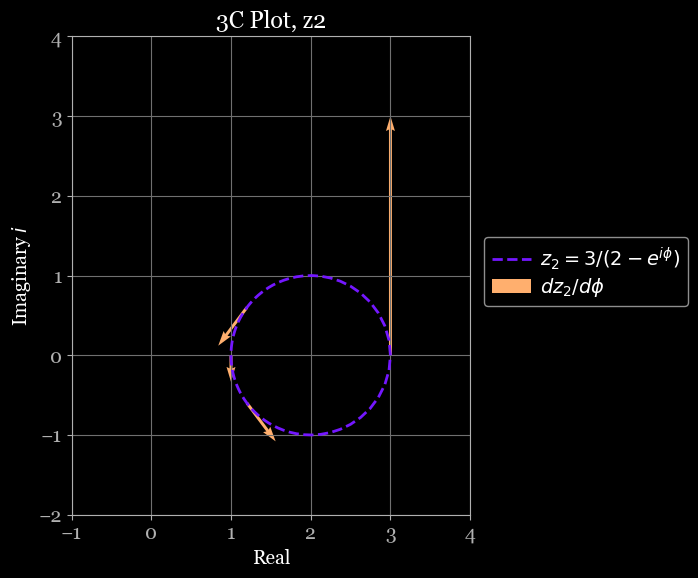

In [167]:
phi_vals = np.array([0, np.pi/2, np.pi, (3 * np.pi)/2])
phis = np.linspace(0, 2 * np.pi, 100)

def dz2(phi):
    dz2 = 3 / (2 - np.exp(1j * phi))
    return z2

def dz2(phi_vals):
    dz2 = (3 * 1j * np.exp(1j * phi_vals))/(2 - np.exp(1j * phi_vals))**2
    return dz2

re2 = z2(phis).real
im2 = z2(phis).imag

re22 = z2(phi_vals).real
im22 = z2(phi_vals).imag

dre2 = dz2(phi_vals).real
dim2 = dz2(phi_vals).imag


print("Velocities at 0, pi/2, pi, and 3pi/2 respectively:","real parts=",dre2,"imag parts=",dim2)


fig = plt.figure(figsize=(11,6))
ax = fig.add_subplot()


arc2, = ax.plot(re2,im2,color="#7417ff", linestyle='dashed', lw=2, label="$z_2 = 3/({2-e^{i\phi}})$")
ax.quiver(re22, im22, dre2, dim2, angles='xy', scale_units='xy',scale=1, color="#ffaf6e",label=r"$dz_2/d\phi$")


ax.set_xlabel("Real")
ax.set_ylabel("Imaginary $i$")
ax.set_xlim([-1, 4])
ax.set_ylim([-2, 4])
ax.grid()

ax.set_title("3C Plot, z2")

ax.legend(bbox_to_anchor=(1.01, 0.6))
ax.set_aspect('equal')

Velocities at 0, pi/2, pi, and 3pi/2 respectively: real parts= [-0.5        -0.45593813  0.10393979  0.09478022] imag parts= [ 1.         -0.22796906 -0.20787958  0.04739011]


<>:28: SyntaxWarning: invalid escape sequence '\s'
<>:28: SyntaxWarning: invalid escape sequence '\s'
/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_19964/3180476769.py:28: SyntaxWarning: invalid escape sequence '\s'
  arc3, = ax.plot(re3,im3,color="#ee387e", lw=2, label="$z_2 = e^{(\sigma + i\omega)\phi} ; \sigma = -0.5, \omega=1$")


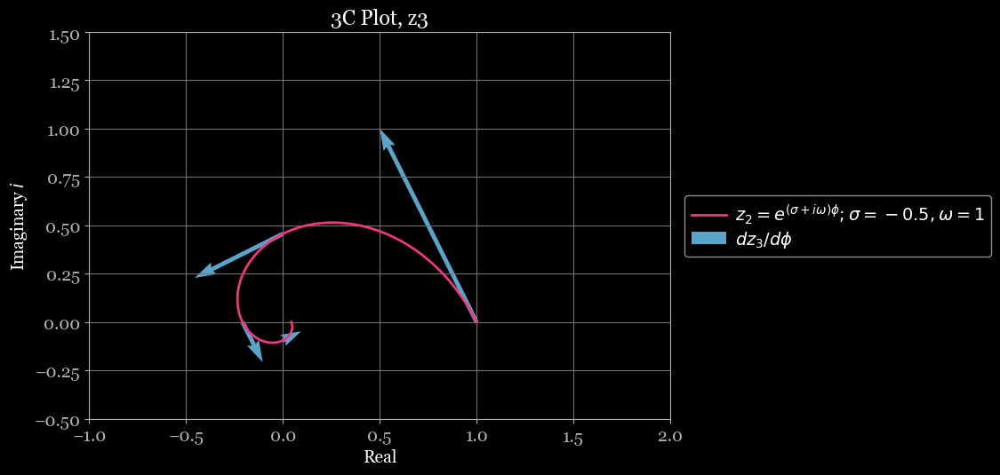

In [166]:
phi_vals = np.array([0, np.pi/2, np.pi, (3 * np.pi)/2])
phis = np.linspace(0, 2 * np.pi, 100)

def z3(phi):
    z3 = np.exp( (-phi/2) + (1j*phi))
    return z3

def dz3(phi_vals):
    dz3 = np.exp( (-phi_vals/2) + (1j*phi_vals))*(1j-(1/2))
    return dz3

re3 = z3(phis).real
im3 = z3(phis).imag

re33 = z3(phi_vals).real
im33 = z3(phi_vals).imag

dre3 = dz3(phi_vals).real
dim3 = dz3(phi_vals).imag

print("Velocities at 0, pi/2, pi, and 3pi/2 respectively:","real parts=",dre3,"imag parts=",dim3)


fig = plt.figure(figsize=(11,6))
ax = fig.add_subplot()


arc3, = ax.plot(re3,im3,color="#ee387e", lw=2, label="$z_2 = e^{(\sigma + i\omega)\phi} ; \sigma = -0.5, \omega=1$")
ax.quiver(re33, im33, dre3, dim3, angles='xy', scale_units='xy',scale=1, color="#5ba5cb",label=r"$dz_3/d\phi$")



ax.set_xlabel("Real")
ax.set_ylabel("Imaginary $i$")
ax.set_xlim([-1, 2])
ax.set_ylim([-0.5, 1.5])
ax.grid()

ax.set_title("3C Plot, z3")

ax.legend(bbox_to_anchor=(1.01, 0.6))
ax.set_aspect('equal')




## Question 3D:

Here the primary difference between z1 and z2 is they have different velocities; z1 has a constant velocity with varying phase, but z2's velocity changes with varying phase. 

## Question 3E:


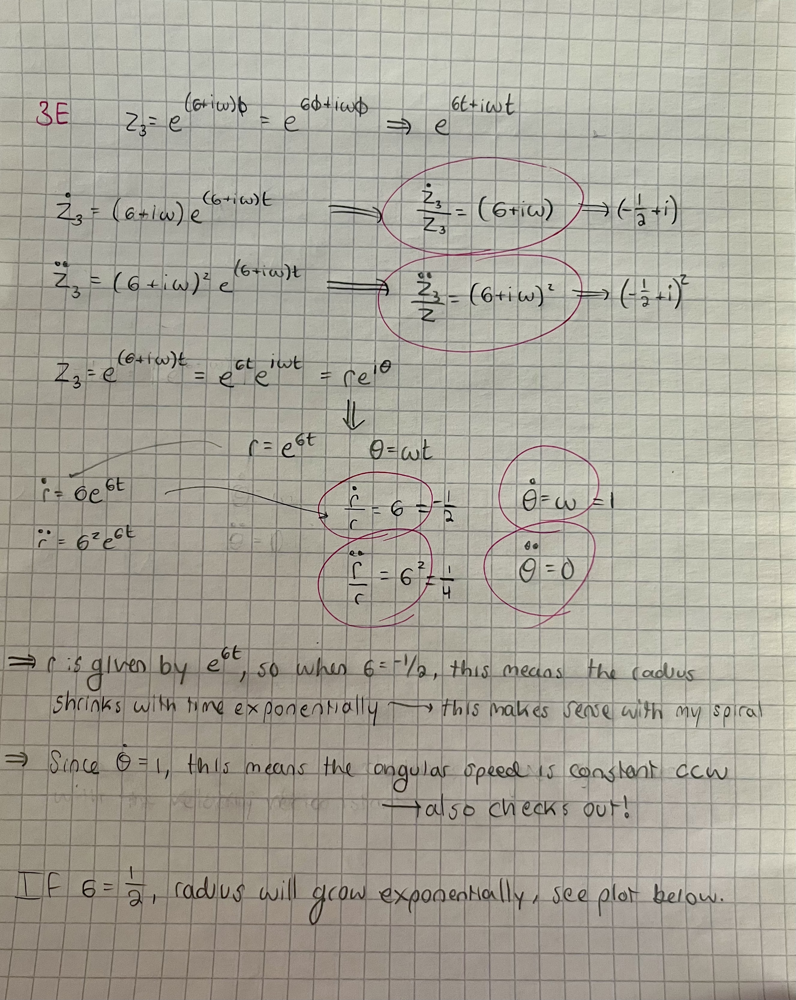



Velocities at 0, pi/2, pi, and 3pi/2 respectively: real parts= [-0.5        -2.19328005  2.40523869 10.55072407] imag parts= [ 1.         -1.09664003 -4.81047738  5.27536204]


<>:28: SyntaxWarning: invalid escape sequence '\s'
<>:28: SyntaxWarning: invalid escape sequence '\s'
/var/folders/fh/3pbmkshx1f76q4pncv9lrxrr0000gn/T/ipykernel_19964/828484464.py:28: SyntaxWarning: invalid escape sequence '\s'
  arc3, = ax.plot(re3,im3,color="#b4ee38", lw=2, label="$z_2 = e^{(\sigma + i\omega)\phi} ; \sigma = 0.5, \omega=1$")


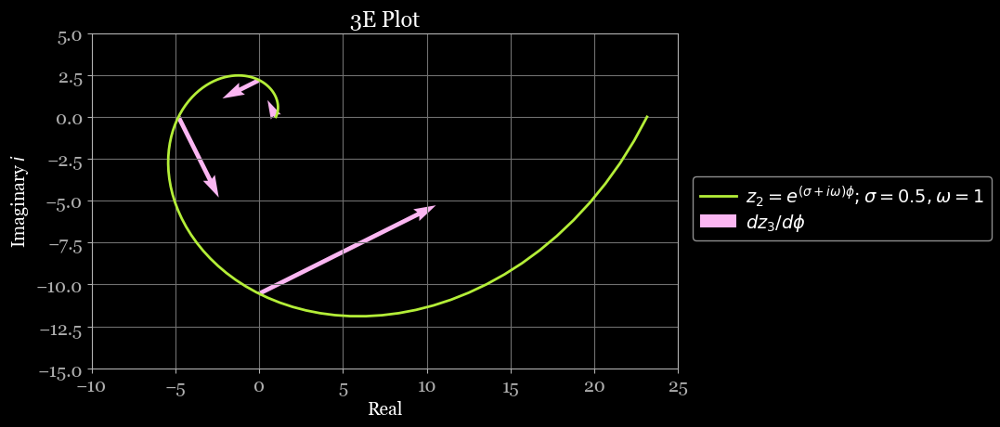

In [168]:
phi_vals = np.array([0, np.pi/2, np.pi, (3 * np.pi)/2])
phis = np.linspace(0, 2 * np.pi, 100)

def z3(phi):
    z3 = np.exp( (phi/2) + (1j*phi))
    return z3

def dz3(phi_vals):
    dz3 = np.exp( (phi_vals/2) + (1j*phi_vals))*(1j-(1/2))
    return dz3

re3 = z3(phis).real
im3 = z3(phis).imag

re33 = z3(phi_vals).real
im33 = z3(phi_vals).imag

dre3 = dz3(phi_vals).real
dim3 = dz3(phi_vals).imag

print("Velocities at 0, pi/2, pi, and 3pi/2 respectively:","real parts=",dre3,"imag parts=",dim3)


fig = plt.figure(figsize=(11,6))
ax = fig.add_subplot()


arc3, = ax.plot(re3,im3,color="#b4ee38", lw=2, label="$z_2 = e^{(\sigma + i\omega)\phi} ; \sigma = 0.5, \omega=1$")
ax.quiver(re33, im33, dre3, dim3, angles='xy', scale_units='xy',scale=1, color="#fbb6f2",label=r"$dz_3/d\phi$")



ax.set_xlabel("Real")
ax.set_ylabel("Imaginary $i$")
ax.set_xlim([-10, 25])
ax.set_ylim([-15, 5])
ax.grid()

ax.set_title("3E Plot")

ax.legend(bbox_to_anchor=(1.01, 0.6))
ax.set_aspect('equal')




# <span style="color: #ff5500">Question 4: Electric field propogating in 2D</a>
In class, we assumed that an plane wave was propogating in the $\hat{k} = \hat{z}$ direction, with the electric field oscillating in the $\hat{x}$ direction.\
Suppose now that the is oscillating in the $\dfrac{1}{\sqrt{2}} (\hat{x} + \hat{y})$ direction: 
\begin{align}
\boldsymbol{E} = E_0 \cos(\vec{k} \cdot \vec{r} - \omega t) \dfrac{1}{\sqrt{2}} (\hat{x} + \hat{y})
\end{align}

## Question 4A:
What direction of propogation $\hat{k}$ and magnetic field vector $\boldsymbol{B}$ are now possible?\
Draw a diagram of the electric field vector and the plane of propogation.

## Question 4B:
What are the expressions for $\hat{k}$ and $\boldsymbol{B}$ if we constrain the direction of propogating to be (partially) in the positive $\hat{x}$ direction? 

# <span style="color:rgb(255, 0, 200)">Question 4: My Answers</a>

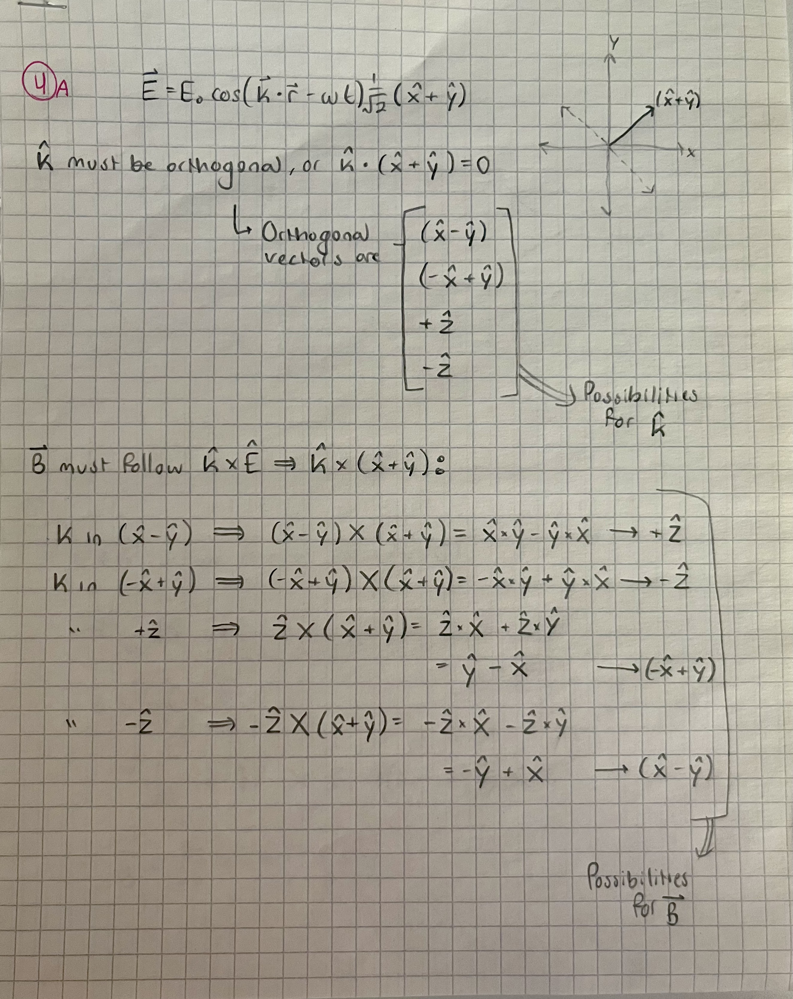

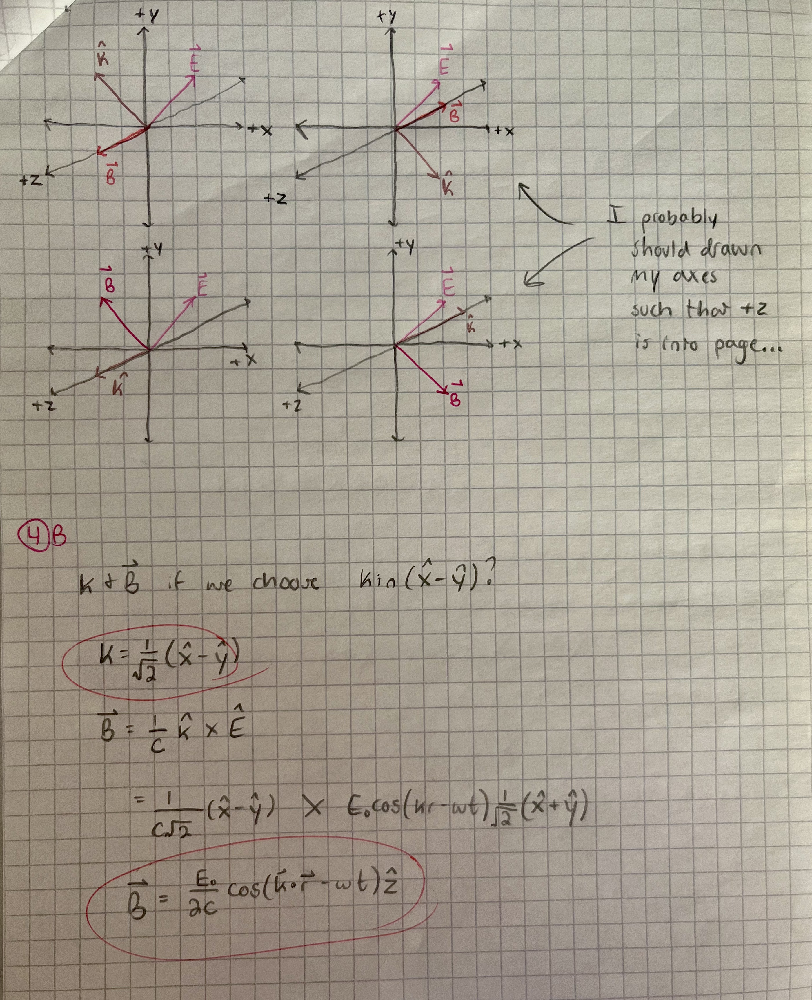

# <span style="color: #ff5500">Question 5: Spherical Plane Wave Intensity and Radiation Pressure</a>

Suppose you have a sinusoidal spherical plane wave source a distance $d$ away along the $\hat{z}$ axis from a cylindrical mirror with radius $a$.\
Use the center of the spherical wave as the origin, and the distance from that center as the variable $r$.\
Assume that the cylinder is in the $xy$ plane.\
Also assume that the spherical wave is emitting total power $P_\mathrm{total}$ in all directions.


## Question 5A:
What is the Poynting vector $\boldsymbol{S}$ for the spherical waves?\
*Hint: Equation 9.49 of Griffith's E&M may be helpful here*

## Question 5B:
What is the Poynting vector $\boldsymbol{S}$ incident on the mirror center?\
What about the mirror edge?\
Write an expression for the Poynting vector incident anywhere on the mirror's surface.

## Question 5C:
Using your result from Question 5B, find the intensity $I$ incident on the mirror.

## Question 5D:
Find the total power $P$ incident on the mirror.\
Compare to the total power emitted by the spherical plane wave.

## Question 5E: 
Calculate the radiation pressure $p_\mathrm{rad}$ incident on the mirror.\
Also find the radiation pressure force $F_\mathrm{rad}$.\
Assume the mirror is a perfect reflector.\
If the mirror has a mass $m$, what is its acceleration?

# <span style="color:rgb(255, 0, 200)">Question 5: My Answers</a>

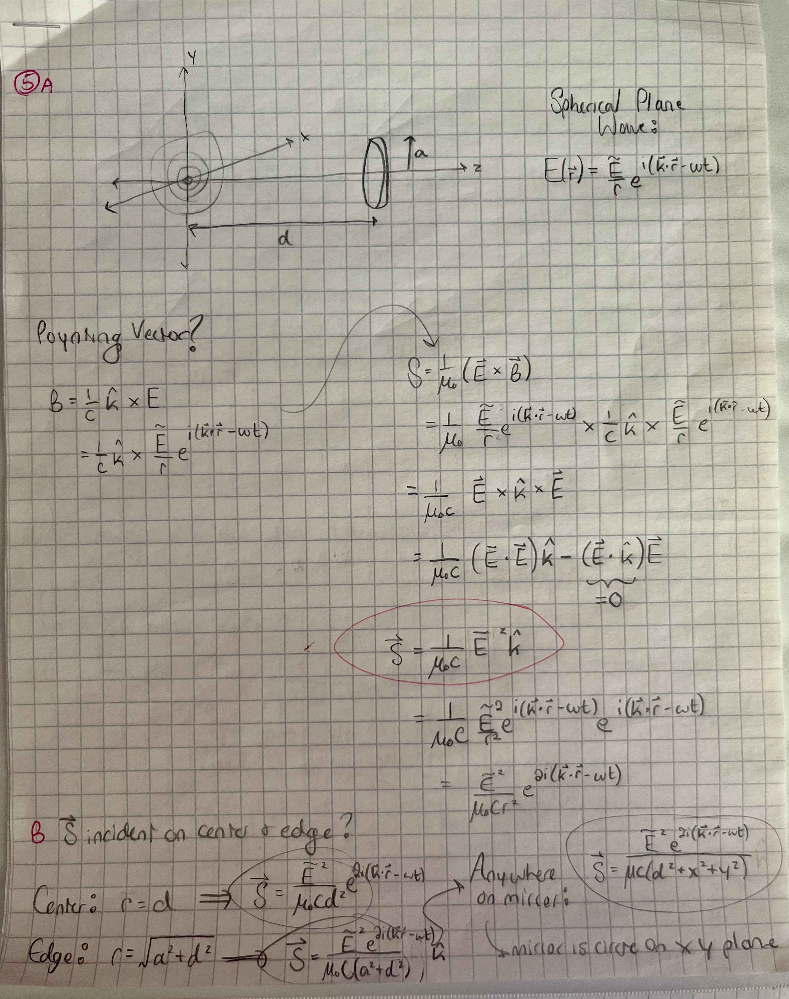

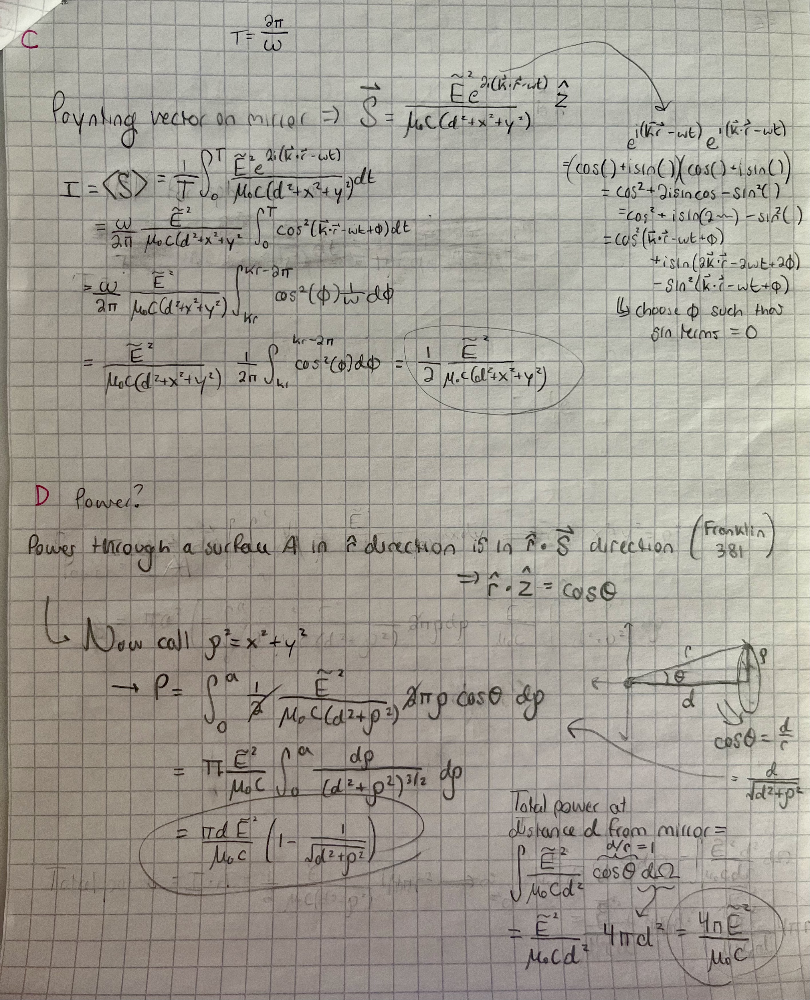

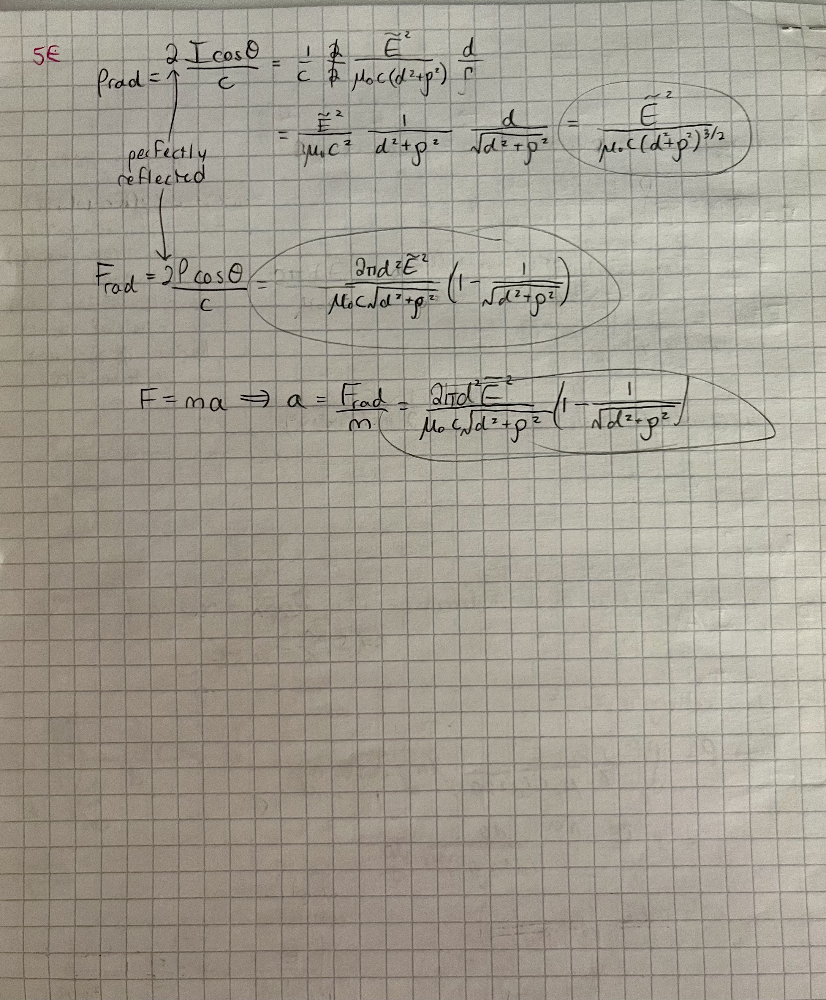